# Gatys Neural Style Transfer

I'm going to implement this https://arxiv.org/abs/1508.06576 paper. It seems to get pretty good results very quickly. I took a lot of inspiration from the implemetation as part of the fast.ai MOOC.

First import everything

In [1]:
import numpy as np
from torch import nn
import torch
from torchvision import transforms
from torchvision.models import vgg16
from scipy import ndimage
import torch.nn.functional as F
from tqdm import tqdm_notebook as tqdm

from PIL import Image

Load the images, feel free to replace these

In [2]:
content = Image.open('house.jpg')
style = Image.open('vangogh.jpg')

Quickly take a look at the two images, we'll downsize them for speed in a bit.

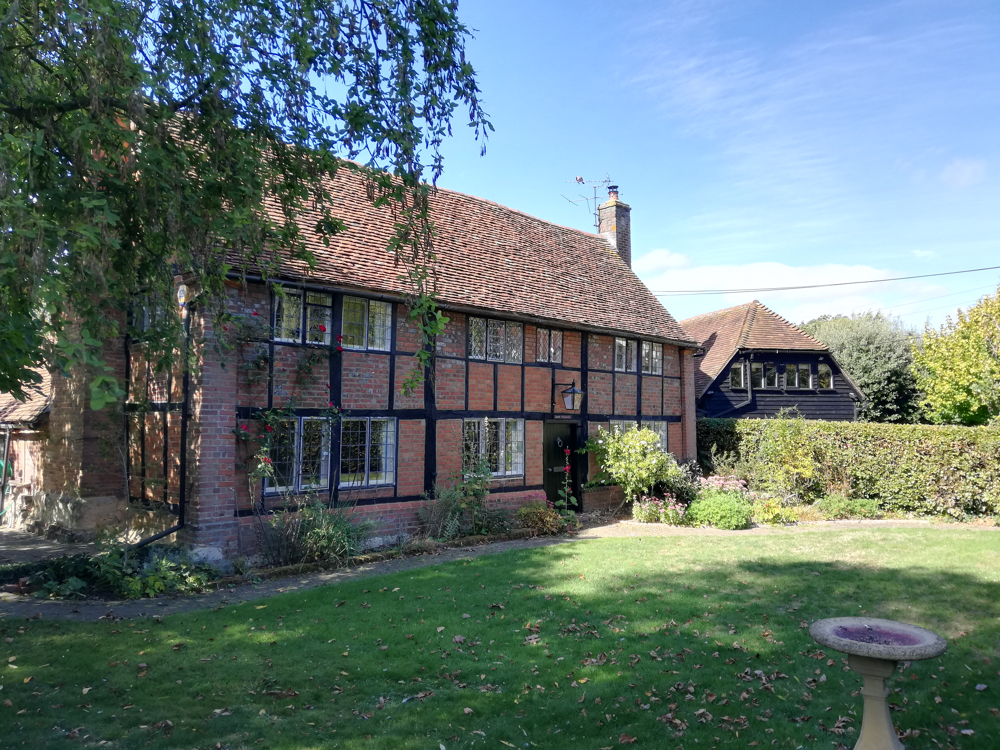

In [3]:
content

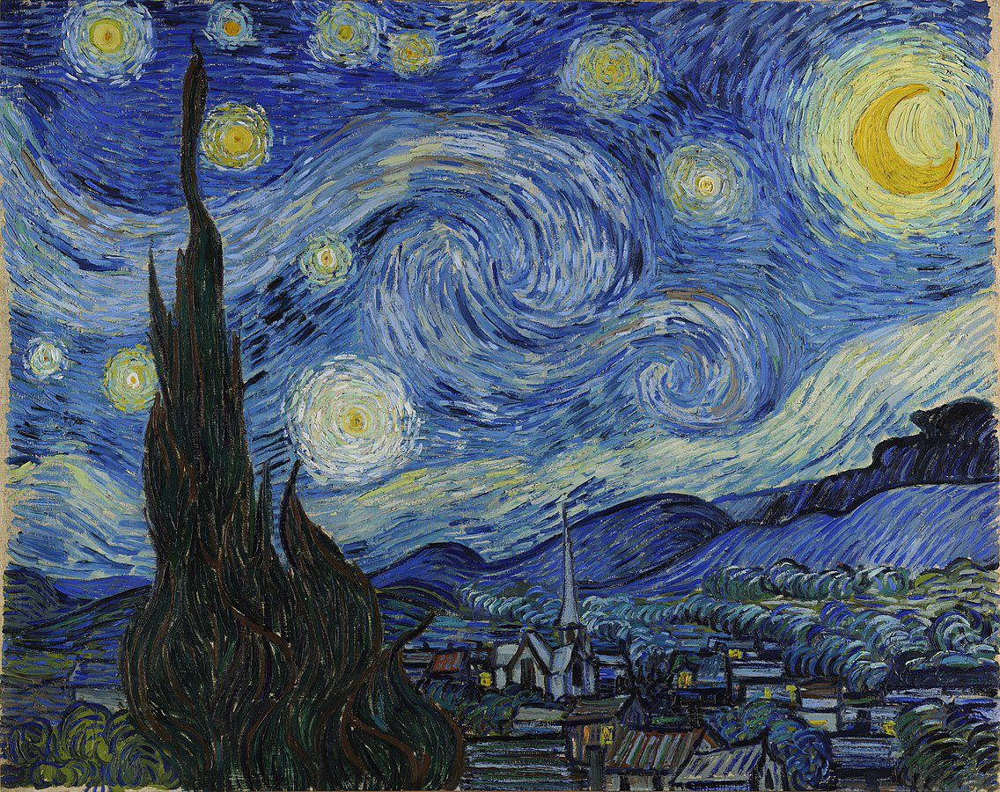

In [4]:
style

Define the backward and forward transformations.

In [22]:
img_size = 512

transform = transforms.Compose([transforms.Resize(img_size),
                                transforms.CenterCrop(img_size),
                                transforms.ToTensor(),
                                transforms.Lambda(lambda x: x.unsqueeze(0)),
                                transforms.Lambda(lambda x: x.cuda())
                               ])

untransform = transforms.Compose([transforms.Lambda(lambda x: x.squeeze()),
                                  transforms.Lambda(lambda x: x.cpu()),
                                  transforms.ToPILImage()
                                 ])

Now define our noise we'll use as the base image to optimise. Smoothing the noise with a median filter leads to more coherant images.

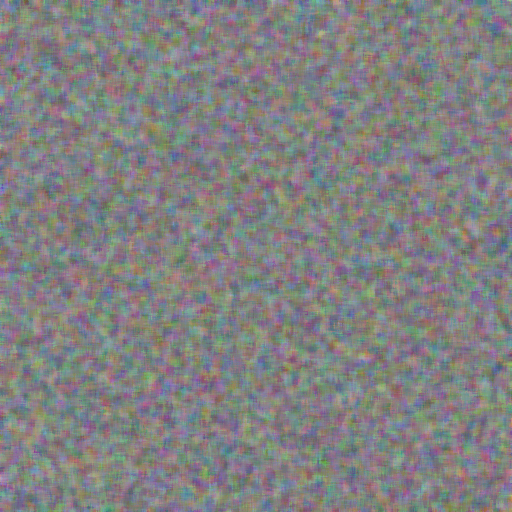

In [23]:
opt_img = np.random.uniform(0, 1, size=(img_size, img_size, 3))
opt_img = ndimage.filters.median_filter(opt_img, (8,8,1))
opt_img = Image.fromarray((255*opt_img).astype('uint8'))
opt_img

Transform the content and style images, we'll re-do the noise just before each experiment.

In [24]:
content_tensor = transform(content)
style_tensor   = transform(style)

Save features class to extract intermediate representations using a forward hook.

In [25]:
class SaveFeatures():
    features = None
    def __init__(self, m): self.hook = m.register_forward_hook(self.hook_fn)
    def hook_fn(self, module, i, o): self.features = o
    def close(self): self.hook.remove()

Import the network and set it to not require gradients.

In [26]:
vgg_fc = vgg16(True).features.cuda()

for param in vgg_fc.parameters():
    param.requires_grad = False

Find the indices for layers just before the max pooling layers.

In [27]:
block_ends = [i-1 for i, o in enumerate(list(vgg_fc.children())) if isinstance(o,nn.MaxPool2d)]
block_ends

[3, 8, 15, 22, 29]

Create a list of SaveFeatures objects.

In [28]:
sfs = [SaveFeatures(list(vgg_fc.children())[idx]) for idx in block_ends]

## Getting the content loss right

First we'll make sure we have a sensible content loss function by transforming our random noise into something like our content image.

Use our save features list to get a static list of the activations from the content target.

In [29]:
vgg_fc(content_tensor)
content_targets = [o.features.detach().clone() for o in sfs]

Define a loss function function. Just the mean squared error between the activation of one layer in our optimisation error and the same layer from the content image. Multiplied  by a large number to keep the loss large enough.

In [30]:
def content_loss(x):
    vgg_fc(x)
    o = sfs[2].features
    return F.mse_loss(o, content_targets[2])*1e6

Now let's experiment trying to recreate the content image.

HBox(children=(IntProgress(value=0, max=10), HTML(value='')))

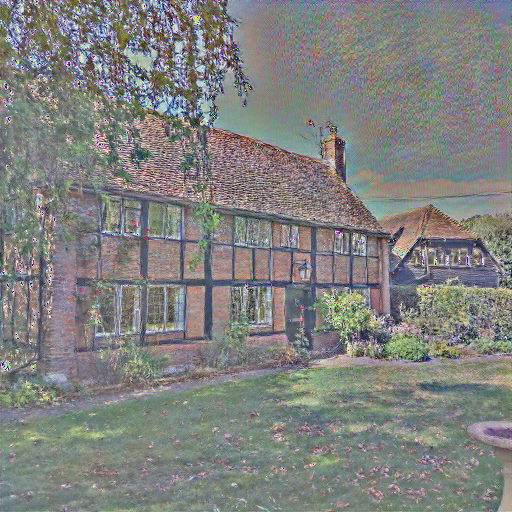

In [31]:
opt_img_tensor = transform(opt_img)
opt_img_tensor.requires_grad = True

opt = torch.optim.LBFGS([opt_img_tensor])

def closure():
    opt.zero_grad()
    loss = content_loss(opt_img_tensor)
    loss.backward()
    return loss

for _ in tqdm(range(10)): opt.step(closure)
    
untransform(opt_img_tensor)

## Style Loss

Now let's get the style loss right. First we need to define the Gram matrix.

In [32]:
def gram_matrix(x):
    b,c,_,_ = x.size()
    x = x.view(b*c, -1)
    return torch.mm(x, x.t())/x.numel()*1e6

Get the targets by calculating the Gram matrix from each activation for the style image.

In [33]:
vgg_fc(style_tensor)
style_targets = [o.features.clone() for o in sfs]

gram_targets = [gram_matrix(layer).detach() for layer in style_targets]

def style_layer_loss(x, style_gram): return F.mse_loss(gram_matrix(x), style_gram)

Function to calculate the style loss by calculating the sum of the MSE between the Gram matrices of the optimisation matrix and the style image.

In [34]:
def style_loss(x):
    vgg_fc(x)
    layers = [o.features.clone() for o in sfs]
    return sum([style_layer_loss(x, y) for x, y in zip(layers, gram_targets)])

Now let's experiment by optimising our style loss.

HBox(children=(IntProgress(value=0, max=10), HTML(value='')))

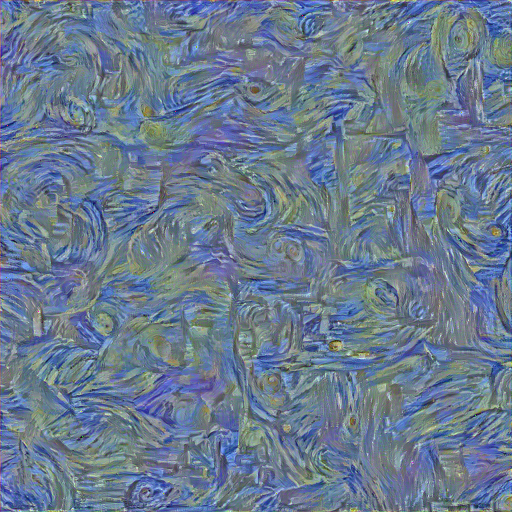

In [35]:
opt_img_tensor = transform(opt_img)
opt_img_tensor.requires_grad = True

opt = torch.optim.LBFGS([opt_img_tensor])

def closure():
    opt.zero_grad()
    loss = style_loss(opt_img_tensor)
    loss.backward()
    return loss

for _ in tqdm(range(10)): opt.step(closure)

untransform(opt_img_tensor)

## Combined loss

Now we'll combine the two and see if we can transfer the loss over.

In [36]:
def combined_loss(x):
    vgg_fc(x)
    layers = [o.features.clone() for o in sfs]
    st_loss = sum([style_layer_loss(x, y) for x, y in zip(layers, gram_targets)])
    cnt_loss = F.mse_loss(layers[2], content_targets[2])*1e6
    return st_loss + cnt_loss

HBox(children=(IntProgress(value=0, max=10), HTML(value='')))

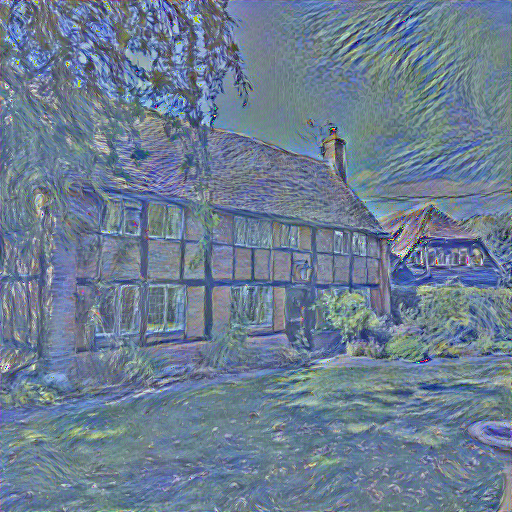

In [37]:
opt_img_tensor = transform(opt_img)
opt_img_tensor.requires_grad = True

opt = torch.optim.LBFGS([opt_img_tensor])

def closure():
    opt.zero_grad()
    loss = combined_loss(opt_img_tensor)
    loss.backward()
    return loss

for _ in tqdm(range(10)): opt.step(closure)

untransform(opt_img_tensor)

In [38]:
style_transfer_image = untransform(opt_img_tensor)
style_transfer_image.save('combined.jpg')